#### Packages

In [2]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorboard.plugins.hparams import api as hp
import numpy as np
import scipy.io
import os
from PIL import Image
from keras_tuner.tuners import GridSearch, RandomSearch, Hyperband, BayesianOptimization
%load_ext tensorboard


#### Dataset

Here we will be using the same dataset as the previous assignments in which the problem is to classify a set of images as cats or not retrieved from https://www.kaggle.com/datasets/samuelcortinhas/cats-and-dogs-image-classification?select=train. We removed the picture "dog_505.png" as it caused problems while preprocessing it. We will first process only 100 images per class (100 cats and 100 dogs for training and another 100 cats and 100 dogs for validation) to reduce their pixel resolution to the same as the other assignments (64 pixels x 64 pixels) and then represent them as arrays.

In [3]:
def preprocess_dataset(dataset):
    dataset_flatten = dataset.reshape(dataset.shape[0],-1).T
    return dataset_flatten/255

def process_images(directory, target_size=(64, 64), image_range=range(0,100)):
    image_list = []

    filenames = sorted(os.listdir(directory))[min(image_range):max(image_range)+1]

    for filename in filenames:
        if filename.endswith(".jpg"):
            file_path = os.path.join(directory, filename)

            img = Image.open(file_path)
            img_resized = img.resize(target_size)
            img_array = np.array(img_resized)

            image_list.append(img_array)

    return np.array(image_list)

def join_cats_and_dogs(cat_images,dog_images):
    cat_set_X = preprocess_dataset(cat_images)
    dog_set_X = preprocess_dataset(dog_images)
    m_cat_set = cat_set_X.shape[1]
    cat_set_Y = np.ones((1, m_cat_set))
    m_dog_set = dog_set_X.shape[1]
    dog_set_Y = np.zeros((1, m_dog_set))

    set_X = np.concatenate((cat_set_X, dog_set_X), axis=1)
    set_Y = np.concatenate((cat_set_Y, dog_set_Y), axis=1)

    np.random.seed(1)
    shuffle_indices = np.random.permutation(set_X.shape[1])
    final_set_X = set_X[:, shuffle_indices]
    final_set_Y = set_Y[:, shuffle_indices]

    return final_set_X,final_set_Y


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
train_cat_images = process_images("/content/drive/MyDrive/Clases/Assignment7-Hyperparameter-Tuning-with-TensorBoard-main/datasets/train/cats")
train_dog_images = process_images("/content/drive/MyDrive/Clases/Assignment7-Hyperparameter-Tuning-with-TensorBoard-main/datasets/train/dogs")

test_cat_images = process_images("/content/drive/MyDrive/Clases/Assignment7-Hyperparameter-Tuning-with-TensorBoard-main/datasets/train/cats",image_range=(101,200))
test_dog_images = process_images("/content/drive/MyDrive/Clases/Assignment7-Hyperparameter-Tuning-with-TensorBoard-main/datasets/train/dogs",image_range=(101,200))

x_train, y_train = join_cats_and_dogs(train_cat_images,train_dog_images)
y_train = y_train.flatten()
x_train = x_train.T


x_test, y_test = join_cats_and_dogs(test_cat_images,test_dog_images)
y_test = y_test.flatten()
x_test = x_test.T


### Tuning Parameters

We'll initially investigate this model using grid search; however, due to the extensive time required to explore all parameters through this method, we plan to examine more advanced models using alternative search techniques later on.

In [6]:
def build_model(hp):
    model = keras.Sequential()
    model.add(layers.Reshape((64, 64, 3), input_shape=(12288,)))

    model_type = hp.Choice("model_type", ["mlp", "cnn"])

    if model_type == "mlp":
        model.add(layers.Flatten())
        # Number of MLP layers
        for i in range(hp.Int("mlp_layers", 2, 3)):
            model.add(layers.Dense(
                units=hp.Int(f"units_{i}", 64, 128, step=32),
                activation="relu"
            ))
    else:
        # Number of CNN layers
        for i in range(hp.Int("cnn_layers", 2, 3)):
            model.add(layers.Conv2D(
                filters=hp.Int(f"filters_{i}", 32, 64, step=16),
                kernel_size=(3, 3),
                padding='same',
                activation="relu"
            ))
            model.add(layers.MaxPooling2D(pool_size=(2, 2)))
        model.add(layers.Flatten())

    if hp.Boolean("dropout"):
        model.add(layers.Dropout(rate=hp.Int('dropout_rate', min_value=10, max_value=50, step=10) / 100.0))

    model.add(layers.Dense(2, activation='softmax'))

    model.compile(
        optimizer=hp.Choice('optimizer', ['adam', 'sgd']),
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )
    return model

### Grid Search

In [7]:
tuner_gs = GridSearch(
    build_model,
    objective='val_accuracy',
    directory='/logs/gs',
    max_trials=375,
    project_name='dogsvscats'
)

tuner_gs.search(x_train, y_train, epochs=5, validation_data=(x_test, y_test),
             callbacks=[keras.callbacks.TensorBoard("/logs/gs/gs_logs")])

Trial 375 Complete [00h 00m 03s]
val_accuracy: 0.5149999856948853

Best val_accuracy So Far: 0.6299999952316284
Total elapsed time: 00h 14m 58s


### More complex model

In [8]:
def build_model(hp):
    model = keras.Sequential([
        # Reshape layer to convert the flattened input back to 64x64x3
        layers.Reshape((64, 64, 3), input_shape=(12288,)),
    ])

    for i in range(hp.Int("num_blocks", 2, 4)):  # Tuning the number of blocks
        num_conv_layers = hp.Int(f"num_conv_{i}", 2, 3)  # Each block can have 2 or 3 conv layers
        filters = hp.Int(f"filters_{i}", 32, 128, step=32)  # Tuning the number of filters

        for _ in range(num_conv_layers):
            model.add(layers.Conv2D(
                filters=filters,
                kernel_size=(3, 3),
                padding='same',
                activation="relu"
            ))

        model.add(layers.MaxPooling2D(pool_size=(2, 2)))

    model.add(layers.Flatten())

    if hp.Boolean("dropout"):
        dropout_rate = hp.Float('dropout_rate', min_value=0.1, max_value=0.5, step=0.1)
        model.add(layers.Dropout(rate=dropout_rate))

    # Dense layer before the output
    model.add(layers.Dense(
        units=hp.Int('dense_units', min_value=64, max_value=512, step=64),
        activation='relu'
    ))

    # Output layer
    model.add(layers.Dense(2, activation='softmax'))

    # Compile the model
    model.compile(
        optimizer=hp.Choice('optimizer', ['adam', 'sgd']),
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )
    return model

### Random Search

In [9]:
tuner_rs = RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=200,
    executions_per_trial=1,
    directory='/logs/rs',
    project_name='dogsvscats'
)

tuner_rs.search(x_train, y_train, epochs=5, validation_data=(x_test, y_test),
             callbacks=[keras.callbacks.TensorBoard("/logs/rs/rs_logs")])

Trial 200 Complete [00h 00m 05s]
val_accuracy: 0.5799999833106995

Best val_accuracy So Far: 0.6349999904632568
Total elapsed time: 00h 19m 34s


In [10]:
best_model = tuner_rs.get_best_models(num_models=1)[0]
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 reshape (Reshape)           (None, 64, 64, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 64, 64, 64)        1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 64)        36928     
                                                                 
 max_pooling2d (MaxPooling2  (None, 32, 32, 64)        0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 96)        55392     
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 96)        83040     
                                                        

### Hyperband search


In [11]:
tuner_hb = Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=10,
    directory='/logs/hb',
    project_name='dogsvscats',
    max_consecutive_failed_trials=6,
)

tuner_hb.search(x_train, y_train, epochs=5, validation_data=(x_test, y_test),
             callbacks=[keras.callbacks.TensorBoard("/logs/hb/hb_logs")])

Trial 30 Complete [00h 00m 08s]
val_accuracy: 0.550000011920929

Best val_accuracy So Far: 0.6000000238418579
Total elapsed time: 00h 02m 56s


In [12]:
best_model = tuner_hb.get_best_models(num_models=1)[0]
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 reshape (Reshape)           (None, 64, 64, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 64, 64, 128)       3584      
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 128)       147584    
                                                                 
 max_pooling2d (MaxPooling2  (None, 32, 32, 128)       0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 96)        110688    
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 96)        83040     
                                                        

### Bayesian Optimization

In [15]:
tuner_bo = BayesianOptimization(
    build_model,
    objective='val_accuracy',
    max_trials=200,
    directory='/logs/bo',
    project_name='dogsvscats',
    max_consecutive_failed_trials=6,
)

tuner_bo.search(x_train, y_train, epochs=5, validation_data=(x_test, y_test),
             callbacks=[keras.callbacks.TensorBoard("/logs/bo/bo_logs")])

Trial 68 Complete [00h 00m 14s]

Best val_accuracy So Far: 0.6050000190734863
Total elapsed time: 00h 10m 30s

Search: Running Trial #69

Value             |Best Value So Far |Hyperparameter
2                 |2                 |num_blocks
3                 |3                 |num_conv_0
32                |32                |filters_0
3                 |3                 |num_conv_1
96                |64                |filters_1
False             |False             |dropout
512               |320               |dense_units
adam              |adam              |optimizer
2                 |3                 |num_conv_2
96                |96                |filters_2
2                 |2                 |num_conv_3
32                |128               |filters_3
0.4               |0.2               |dropout_rate



Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 274, in _try_run_and_update_trial
    self._run_and_update_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 239, in _run_and_update_trial
    results = self.run_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 314, in run_trial
    obj_value = self._build_and_fit_model(trial, *args, **copied_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 232, in _build_and_fit_model
    model = self._try_build(hp)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 164, in _try_build
    model = self._build_hypermodel(hp)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 155, in _build_hypermodel
    model

RuntimeError: Number of consecutive failures exceeded the limit of 6.
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 274, in _try_run_and_update_trial
    self._run_and_update_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 239, in _run_and_update_trial
    results = self.run_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 314, in run_trial
    obj_value = self._build_and_fit_model(trial, *args, **copied_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 232, in _build_and_fit_model
    model = self._try_build(hp)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 164, in _try_build
    model = self._build_hypermodel(hp)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 155, in _build_hypermodel
    model = self.hypermodel.build(hp)
  File "<ipython-input-8-7b634fb7df74>", line 30, in build_model
    model.add(layers.Dense(
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/trackable/base.py", line 204, in _method_wrapper
    result = method(self, *args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 70, in error_handler
    raise e.with_traceback(filtered_tb) from None
  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend.py", line 2100, in random_uniform
    return tf.random.stateless_uniform(
tensorflow.python.framework.errors_impl.ResourceExhaustedError: {{function_node __wrapped__AddV2_device_/job:localhost/replica:0/task:0/device:GPU:0}} failed to allocate memory [Op:AddV2] name: 


In [16]:
best_model = tuner_bo.get_best_models(num_models=1)[0]
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 reshape (Reshape)           (None, 64, 64, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 64, 64, 32)        896       
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        9248      
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 32)        9248      
                                                                 
 max_pooling2d (MaxPooling2  (None, 32, 32, 32)        0         
 D)                                                              
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 64)        18496     
                                                        

 flatten (Flatten)           (None, 16384)             0         


                                                                 
 dense (Dense)               (None, 320)               5243200   


 dense_1 (Dense)             (None, 2)                 642       
                                                                 


Total params: 5355586 (20.43 MB)
Trainable params: 5355586 (20.43 MB)


Non-trainable params: 0 (0.00 Byte)


_________________________________________________________________


## Tensorboard

#### Grid Search

In [26]:
%tensorboard --logdir /log/gs/gs_logs

Reusing TensorBoard on port 6006 (pid 134171), started 0:07:55 ago. (Use '!kill 134171' to kill it.)

<IPython.core.display.Javascript object>

![Sin título.jpeg](<attachment:Sin título.jpeg>)
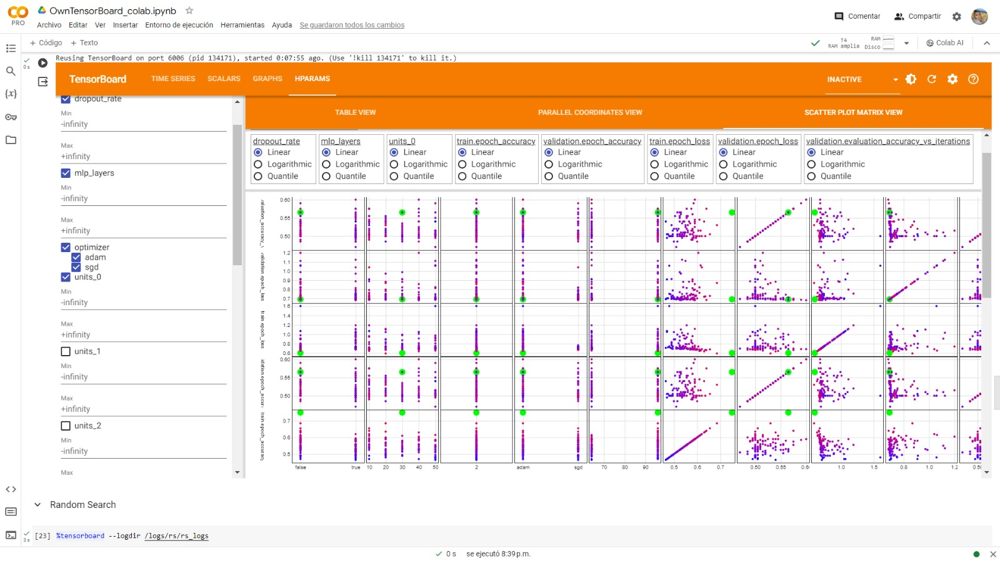

#### Random Search

In [23]:
%tensorboard --logdir /logs/rs/rs_logs

<IPython.core.display.Javascript object>

![Sin título-1.jpeg](<attachment:Sin título-1.jpeg>)
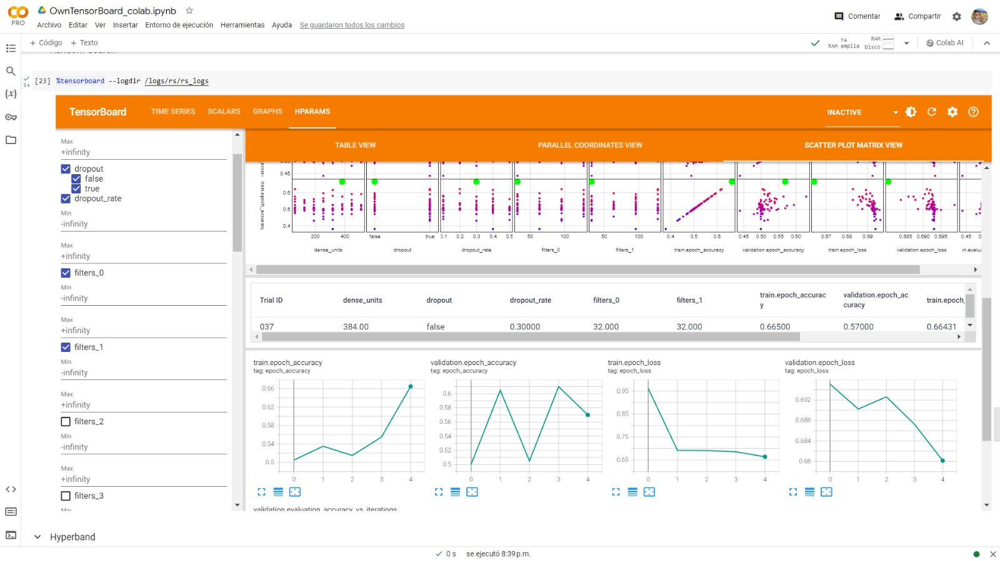

#### Hyperband

In [24]:
%tensorboard --logdir /logs/hb/hb_logs

<IPython.core.display.Javascript object>

![Sin título.jpeg](<attachment:Sin título.jpeg>)
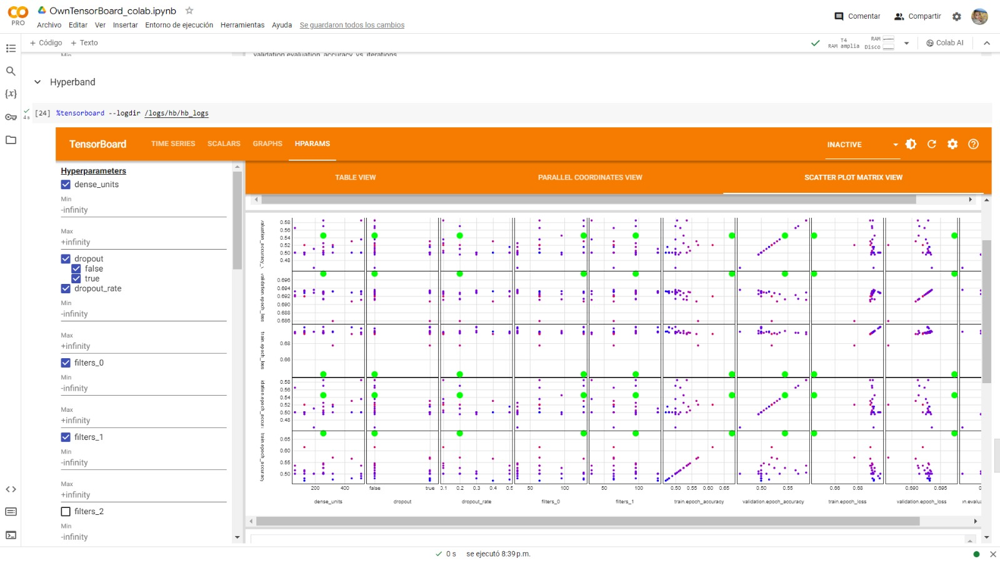

#### Bayesian Optimization

In [25]:
%tensorboard --logdir /logs/bo/bo_logs

<IPython.core.display.Javascript object>

![Sin título-1.jpeg](<attachment:Sin título-1.jpeg>)
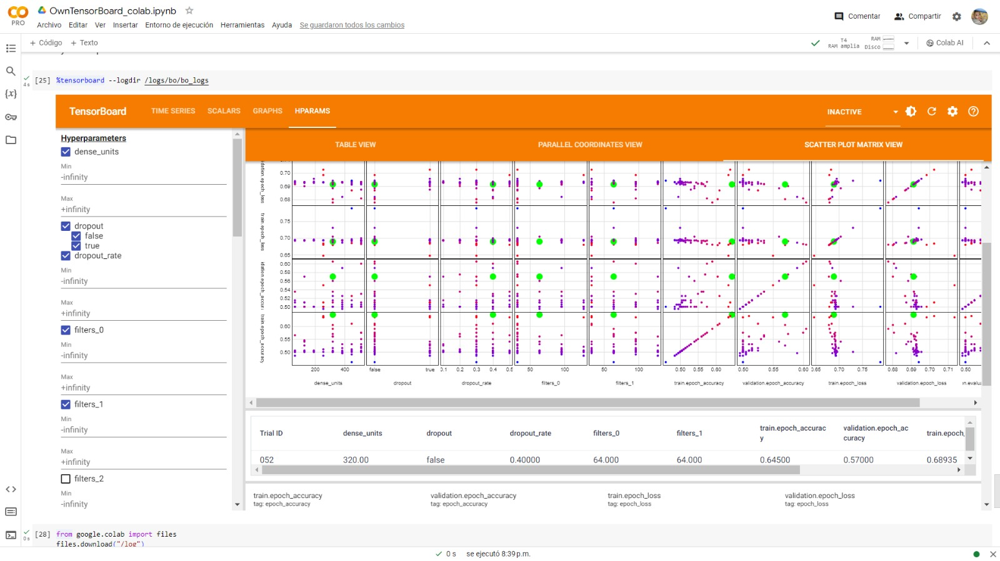

## Conclusions

Grid search was the most time-consuming method for parameter optimization because it evaluates every possible combination. In our case, we limited the number of trials to 375, achieving an accuracy of 0.62999, but did not extend our exploration to the CNN model. Conversely, Hyperband proved to be the quickest method, yet it yielded the lowest accuracy at 0.60000 on the validation set. The Bayesian optimizer showed promise but was hindered by excessive GPU RAM usage, completing only 69 of the planned 200 trials with an accuracy of 0.60500. Random search emerged as the most effective optimizer, successfully completing all intended trials and achieving the highest accuracy of 0.63499. We observed the highest accuracies in models without dropout, and among the varying dropout rates, 0.3 was optimal. There are several potential enhancements for future experiments: increasing the number of blocks in the model, extending the epochs per model (currently set at 5), refining the parameter increments for more precise tuning, augmenting the number of trials per optimizer, and upgrading the GPU power, where a T4 GPU was used in this study.